# Case Study 3 : Data Science in NYC Taxi and Uber Data

**Required Readings:** 
* [Analyzing 1.1 Billion NYC Taxi and Uber Trips](http://toddwschneider.com/posts/analyzing-1-1-billion-nyc-taxi-and-uber-trips-with-a-vengeance/) 
* Please download the NYC taxi and Uber dataset from [here](https://github.com/toddwschneider/nyc-taxi-data).
* [TED Talks](https://www.ted.com/talks) for examples of 7 minutes talks.


**NOTE**
* Please don't forget to save the notebook frequently when working in Jupyter Notebook, otherwise the changes you made can be lost.

----------------------

# Problem: pick a data science problem that you plan to solve using Uber/Taxi Data
* The problem should be important and interesting, which has a potential impact in some area.
* The problem should be solvable using the data and data science solutions.

Please briefly describe in the following cell: what problem are you trying to solve? why this problem is important and interesting?

In [0]:
#Our case study focuses on finding the 10 most popular uber pickup locations in New York City
# We have used K means clustering to find out the most popular pickup locations.
# Then using Folium we have plotted the cluster centers and data points on the NYC map
# Then using geopy package we have found the exact place name for the latitude and longitude of the k means centroids.
# Finally we have found the busiest day and time for uber pickups in NYC.

# Data Collection/Processing: 

In [2]:
#----------------------------------------------
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import itertools
import datetime as dt
import matplotlib.pyplot as plt
import pandas as pd
import folium
from sklearn.cluster import KMeans


%matplotlib inline


uber2014 = pd.concat([pd.read_csv('uber-raw-data-apr14.csv'),
                          pd.read_csv('uber-raw-data-may14.csv'),
                          pd.read_csv('uber-raw-data-jun14.csv'),
                          pd.read_csv('uber-raw-data-jul14.csv'),
                          pd.read_csv('uber-raw-data-aug14.csv'),
                          pd.read_csv('uber-raw-data-sep14.csv')])
uber2014.head(10)


,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
5,4/1/2014 0:33:00,40.7383,-74.0403,B02512
6,4/1/2014 0:39:00,40.7223,-73.9887,B02512
7,4/1/2014 0:45:00,40.7620,-73.9790,B02512
8,4/1/2014 0:55:00,40.7524,-73.9960,B02512
9,4/1/2014 1:01:00,40.7575,-73.9846,B02512


# Data Exploration: Exploring the Uber/Taxi Dataset

**plot the spatial distribution of the pickup locations of 5000 Uber trips** 
* collect a set of 5000 Uber trips
* plot the distribution of the pickup locations using a scatter plot figure.

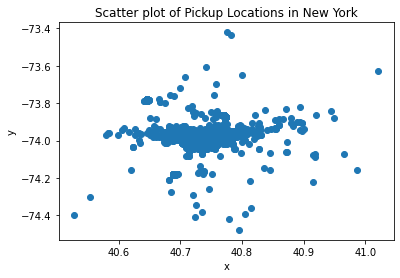

In [3]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary
#Plotting first 5000 data points
uber2014_5000=uber2014[0:5000]
uberFirst5000Data = folium.Map(
    location=[40.7128, -74.0060] # Location: NY
)

location = zip(uber2014_5000['Lat'], uber2014_5000['Lon'])
for l in location:
    folium.Circle(location=l, radius=10).add_to(uberFirst5000Data)
uberFirst5000Data.save('foliumUber.html')
x = uber2014_5000['Lat']
y = uber2014_5000['Lon']
plt.scatter(x, y)
plt.title('Scatter plot of Pickup Locations in New York')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

# The Solution: implement a data science solution to the problem you are trying to solve.

Briefly describe the idea of your solution to the problem in the following cell:

In [0]:
# K means Clustering: In K means clustering using scktlearn library,we have chosen K = 10 to find the 10 most popular uber pickup locations in NYC.
# Folium: Using Folium package we have plotted the cluster centers and data points on the NEW YORK City map.
# Geopy: Using Geopy package we have found the place name for the latitude and longitude of the cluster centroids.
# Finding the busiest Day and Time

Write codes to implement the solution in python:

In [5]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary
#
lats = uber2014['Lat']
lons = uber2014['Lon']
date = uber2014['Date/Time']
coordinates = np.vstack((date,lats,lons)).T
sample = coordinates[np.random.choice(len(coordinates),20000)]
date = sample[:,0]
sample_lats = sample[:,1]
sample_lons = sample[:,2]


X = list(zip(sample_lats, sample_lons))

kmeans = KMeans(n_clusters=10, random_state=0).fit(X)
n_cluster = kmeans.cluster_centers_
n_cluster


array([[ 40.76351423, -73.97492196],
       [ 40.69928634, -74.20073659],
       [ 40.65458989, -73.78272563],
       [ 40.66772161, -73.98164272],
       [ 40.72996309, -73.99822212],
       [ 40.70846988, -73.94752666],
       [ 40.82969189, -73.94152036],
       [ 41.00527805, -73.77202195],
       [ 40.769375  , -73.52641136],
       [ 40.76441664, -73.87216129]])

In [6]:
n = len(n_cluster)
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="uber_app")
for i  in range(n):
    street = geolocator.reverse(str(n_cluster[i][0])+","+str(n_cluster[i][1]))
    print("->",street.address)

-> Solow Building, 9, West 57th Street, Midtown, Manhattan, Manhattan Community Board 5, New York County, New York, 10019, United States of America
-> Oval Road, Newark, Essex County, New Jersey, 07112, United States of America
-> North Hangar Road, Rochdale Village, Bayswater, Queens, New York, Queens County, New York, 11422:11434, United States of America
-> 398, 8th Street, Park Slope, New York, Brooklyn, Kings County, New York, 11215, United States of America
-> Global Center for Academic and Spiritual Life, 238, Thompson Street, Greenwich Village, Washington Square Village, Manhattan, Manhattan Community Board 2, New York, New York County, New York, 10012, United States of America
-> 67, Scholes Street, Williamsburg, New York, Brooklyn, Kings County, New York, 11206, United States of America
-> 876, Saint Nicholas Avenue, Manhattan, Sugar Hill, New York, Manhattan Community Board 9, New York County, New York, 10032, United States of America
-> 98, Cushman Road, Murray Hill, Scarsd

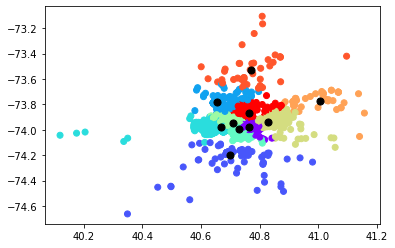

In [7]:
plt.scatter(sample_lats, sample_lons, c = kmeans.labels_ , cmap = 'rainbow')
plt.scatter(n_cluster[:, 0], n_cluster[:, 1], s=50, c='black')
plt.show()

In [8]:
Final_uber = pd.DataFrame(sample)
Final_uber['Cluster_label'] = kmeans.labels_

Final_uber.columns=['Time','Lat','Lon','Cluster_label']
Final_uber.head(10)

,Time,Lat,Lon,Cluster_label
0,9/18/2014 7:26:00,40.8629,-73.9281,6
1,7/13/2014 23:19:00,40.7146,-74.0156,4
2,4/8/2014 6:57:00,40.7111,-74.0054,4
3,4/3/2014 17:44:00,40.7418,-73.9863,4
4,8/9/2014 19:52:00,40.7231,-73.8095,2
5,8/9/2014 18:53:00,40.7351,-73.9569,5
6,4/24/2014 9:19:00,40.77,-73.9585,0
7,9/25/2014 10:11:00,40.873,-74.4261,1
8,6/27/2014 9:43:00,40.6875,-73.9984,3
9,6/3/2014 12:12:00,40.7107,-73.96,5


In [9]:
import folium
cluster_map = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=11
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(Final_uber['Lat'], Final_uber['Lon'],Final_uber['Cluster_label'])
for l in locationlst:
    folium.Circle(radius=20,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map)
    
locationlst1 = zip(n_cluster[:, 0], n_cluster[:, 1])
for l in locationlst1:
    folium.Marker(location=(l[0],l[1])).add_to(cluster_map)
    
cluster_map #.save('Clusters of NYC Uber pickups.html')
#may not see the map in chrome, please open with firefox

In [10]:
Grouped = Final_uber.groupby('Cluster_label').count().reset_index()
Grouped
Most_popular = Grouped.sort_values('Time', ascending = False)
Most_popular

,Cluster_label,Time,Lat,Lon
4,4,8003,8003,8003
0,0,7271,7271,7271
5,5,1357,1357,1357
3,3,1209,1209,1209
9,9,758,758,758
6,6,558,558,558
2,2,554,554,554
1,1,205,205,205
8,8,44,44,44
7,7,41,41,41


[Text(0, 0.5, 'No. of Pickups'),
 Text(0.5, 0, 'Cluster No.'),
 Text(0.5, 1.0, 'Highest number of Pickup Zones')]

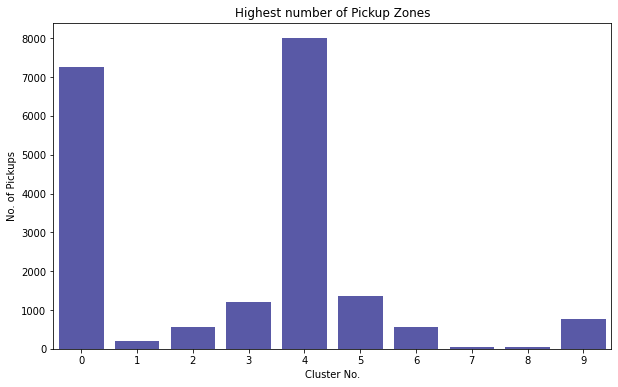

In [11]:
import seaborn as sns
plt.figure(figsize=(10,6))
ax = sns.countplot(Final_uber['Cluster_label'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Cluster No.', ylabel = 'No. of Pickups',title='Highest number of Pickup Zones')


In [12]:
data_subset=Final_uber.loc[Final_uber['Cluster_label']==Most_popular.iloc[0][0]]
data_subset.head(10) 

,Time,Lat,Lon,Cluster_label
1,7/13/2014 23:19:00,40.7146,-74.0156,4
2,4/8/2014 6:57:00,40.7111,-74.0054,4
3,4/3/2014 17:44:00,40.7418,-73.9863,4
12,9/15/2014 8:31:00,40.742,-74.0037,4
14,8/1/2014 23:51:00,40.7305,-74.0045,4
15,9/13/2014 11:01:00,40.7165,-73.9883,4
16,6/7/2014 1:05:00,40.7197,-73.9993,4
22,4/18/2014 21:27:00,40.7405,-73.9892,4
23,5/10/2014 20:53:00,40.7229,-73.9961,4
24,5/3/2014 23:08:00,40.7376,-73.9914,4


In [13]:
xTrain = list(zip(data_subset['Lat'], data_subset['Lon']))
kmeans2 = KMeans(n_clusters=10, random_state=0).fit(xTrain)
kmeans2.labels_
n_cluster2 = kmeans2.cluster_centers_
n_cluster2

array([[ 40.72522257, -73.98358373],
       [ 40.70932905, -74.01058379],
       [ 40.74402896, -74.00521685],
       [ 40.74531644, -73.99324814],
       [ 40.72321337, -73.99498338],
       [ 40.72070295, -74.00597875],
       [ 40.732431  , -74.00262626],
       [ 40.70568421, -73.9900193 ],
       [ 40.73726487, -73.98668271],
       [ 40.73676846, -74.03891141]])

In [14]:
n_subset = len(n_cluster2)
for i  in range(n_subset):
    sub_street = geolocator.reverse(str(n_cluster2[i][0])+","+str(n_cluster2[i][1]))
    print("->",sub_street.address)

-> 504, East 6th Street, Alphabet City, Manhattan, Manhattan Community Board 3, New York County, New York, 10009, United States of America
-> Double Check, Liberty Street, Financial District, Manhattan, Manhattan Community Board 1, New York County, New York, 10005, United States of America
-> 438, West 18th Street, Robert Fulton Houses, Manhattan, Manhattan Community Board 4, New York County, New York, 10011, United States of America
-> 142, West 26th Street, Chelsea, Manhattan, Manhattan Community Board 4, New York County, New York, 10001, United States of America
-> 32, Prince Street, SoHo, Manhattan, Manhattan Community Board 2, New York County, New York, 10012, United States of America
-> 2, Saint John's Lane, Tribeca, Manhattan, Manhattan Community Board 1, New York County, New York, 10013, United States of America
-> 19, Barrow Street, West Village, Manhattan, New York, Manhattan Community Board 2, New York County, New York, 10014, United States of America
-> Manhattan Bridge, Cr

In [15]:
data_subset['Cluster_sub_label'] = kmeans2.labels_
data_subset.head(10)

,Time,Lat,Lon,Cluster_label,Cluster_sub_label
1,7/13/2014 23:19:00,40.7146,-74.0156,4,1
2,4/8/2014 6:57:00,40.7111,-74.0054,4,1
3,4/3/2014 17:44:00,40.7418,-73.9863,4,8
12,9/15/2014 8:31:00,40.742,-74.0037,4,2
14,8/1/2014 23:51:00,40.7305,-74.0045,4,6
15,9/13/2014 11:01:00,40.7165,-73.9883,4,4
16,6/7/2014 1:05:00,40.7197,-73.9993,4,4
22,4/18/2014 21:27:00,40.7405,-73.9892,4,8
23,5/10/2014 20:53:00,40.7229,-73.9961,4,4
24,5/3/2014 23:08:00,40.7376,-73.9914,4,8


In [16]:
cluster_map2 = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=13
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(data_subset['Lat'], data_subset['Lon'],data_subset['Cluster_sub_label'])
for l in locationlst:
    folium.Circle(radius=10,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map2)
cluster_map2
#may not see the map in chrome, please open with firefox

In [17]:
from datetime import datetime

data_subset['timedate']=pd.to_datetime(data_subset['Time'], format='%m/%d/%Y %H:%M:%S')
data_subset=pd.DataFrame(data_subset)
data_subset['hour']=data_subset['timedate'].dt.hour
data_subset['weekday']=data_subset['timedate'].dt.dayofweek

morning = range(6,12)
afternoon = range(12,17)
evening = range(17,20)
night = range(20,24)
latenight=range(0,6)


timeoftheday = np.empty(len(data_subset),dtype='S10')
timeoftheday[np.where(np.in1d(data_subset['hour'],latenight))] = 'Midnight'
timeoftheday[np.where(np.in1d(data_subset['hour'],morning))] = 'Morning'
timeoftheday[np.where(np.in1d(data_subset['hour'],afternoon))] = 'Afternoon'
timeoftheday[np.where(np.in1d(data_subset['hour'],evening))] = 'Evening'
timeoftheday[np.where(np.in1d(data_subset['hour'],night))] = 'Night'
data_subset['timeoftheday'] = timeoftheday
data_subset.head(10)

,Time,Lat,Lon,Cluster_label,Cluster_sub_label,timedate,hour,weekday,timeoftheday
1,7/13/2014 23:19:00,40.7146,-74.0156,4,1,2014-07-13 23:19:00,23,6,b'Night'
2,4/8/2014 6:57:00,40.7111,-74.0054,4,1,2014-04-08 06:57:00,6,1,b'Morning'
3,4/3/2014 17:44:00,40.7418,-73.9863,4,8,2014-04-03 17:44:00,17,3,b'Evening'
12,9/15/2014 8:31:00,40.742,-74.0037,4,2,2014-09-15 08:31:00,8,0,b'Morning'
14,8/1/2014 23:51:00,40.7305,-74.0045,4,6,2014-08-01 23:51:00,23,4,b'Night'
15,9/13/2014 11:01:00,40.7165,-73.9883,4,4,2014-09-13 11:01:00,11,5,b'Morning'
16,6/7/2014 1:05:00,40.7197,-73.9993,4,4,2014-06-07 01:05:00,1,5,b'Midnight'
22,4/18/2014 21:27:00,40.7405,-73.9892,4,8,2014-04-18 21:27:00,21,4,b'Night'
23,5/10/2014 20:53:00,40.7229,-73.9961,4,4,2014-05-10 20:53:00,20,5,b'Night'
24,5/3/2014 23:08:00,40.7376,-73.9914,4,8,2014-05-03 23:08:00,23,5,b'Night'


[Text(0, 0.5, 'Count'), Text(0.5, 0, 'Day of week')]

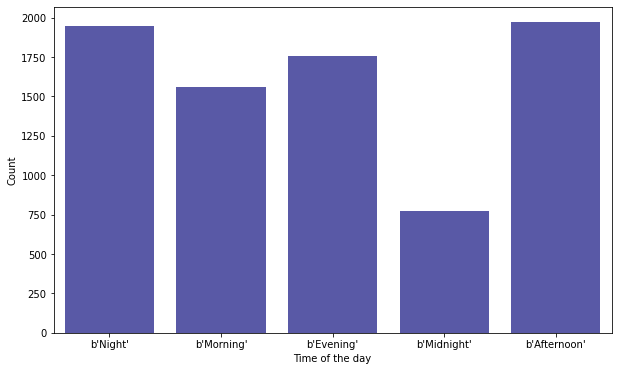

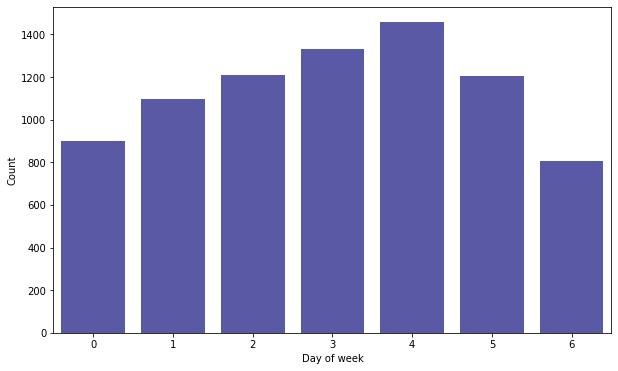

In [18]:
plt.figure(figsize=(10,6))
ax = sns.countplot(data_subset['timeoftheday'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Time of the day', ylabel = 'Count')

plt.figure(figsize=(10,6))
ax = sns.countplot(data_subset['weekday'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Day of week', ylabel = 'Count')

# Results: summarize and visualize the results discovered from the analysis

Please use figures, tables, or videos to communicate the results with the audience.


In [19]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary

import folium
cluster_map = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=11
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(Final_uber['Lat'], Final_uber['Lon'],Final_uber['Cluster_label'])
for l in locationlst:
    folium.Circle(radius=20,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map)
    
locationlst1 = zip(n_cluster[:, 0], n_cluster[:, 1])
for l in locationlst1:
    folium.Marker(location=(l[0],l[1])).add_to(cluster_map)
    
cluster_map
#may not see the map in chrome, please open with firefox

*-----------------
# Done

All set! 

** What do you need to submit?**

* **Notebook File**: Save this Jupyter notebook, and find the notebook file in your folder (for example, "filename.ipynb"). This is the file you need to submit. Please make sure all the plotted tables and figures are in the notebook. If you used "jupyter notebook --pylab=inline" to open the notebook, all the figures and tables should have shown up in the notebook.

* **PPT Slides**: please prepare PPT slides (for 7 minutes' talk) to present about the case study . Each team present their case studies in class for 7 minutes.

Please compress all the files in a zipped file.


**How to submit:**

        Please submit through Canvas, in the Assignment "Case Study 3".
        
**Note: Each team only needs to submit one submission in Canvas**


# Peer-Review Grading Template:

**Total Points: (100 points)** Please don't worry about the absolute scores, we will rescale the final grading according to the performance of all teams in the class.

Please add an "**X**" mark in front of your rating: 

For example:

*2: bad*
          
**X** *3: good*
    
*4: perfect*


    ---------------------------------
    The Problem: 
    ---------------------------------
    
    1. (10 points) how well did the team describe the problem they are trying to solve using the data? 
       0: not clear
       2: I can barely understand the problem
       4: okay, can be improved
       6: good, but can be improved
       8: very good
       10: crystal clear
    
    2. (10 points) do you think the problem is important or has a potential impact?
        0: not important at all
        2: not sure if it is important
        4: seems important, but not clear
        6: interesting problem
        8: an important problem, which I want to know the answer myself
       10: very important, I would be happy invest money on a project like this.
    
    ----------------------------------
    Data Collection and Processing:
    ----------------------------------
    
    3. (10 points) Do you think the data collected/processed are relevant and sufficient for solving the above problem? 
       0: not clear
       2: I can barely understand what data they are trying to collect/process
       4: I can barely understand why the data is relevant to the problem
       6: the data are relevant to the problem, but better data can be collected
       8: the data collected are relevant and at a proper scale
      10: the data are properly collected and they are sufficient

    -----------------------------------
    Data Exploration:
    -----------------------------------
    4. How well did the team solve the following task:
    
    (1) plot the spatial distribution of the pickup locations of 5000 Uber trips (10 points):
       0: missing answer
       4: okay, but with major problems
       7: good, but with minor problems
      10: perfect
    

    -----------------------------------
    The Solution
    -----------------------------------
    5.  how well did the team describe the solution they used to solve the problem? (10 points)
       0: not clear
       2: I can barely understand
       4: okay, can be improved
       6: good, but can be improved
       8: very good
       10: crystal clear
       
    6. how well is the solution in solving the problem? (10 points)
       0: not relevant
       2: barely relevant to the problem
       4: okay solution, but there is an easier solution.
       6: good, but can be improved
       8: very good, but solution is simple/old
       10: innovative and technically sound
       
    7. how well did the team implement the solution in python? (10 points)
       0: the code is not relevant to the solution proposed
       2: the code is barely understandable, but not relevant
       4: okay, the code is clear but incorrect
       6: good, the code is correct, but with major errors
       8: very good, the code is correct, but with minor errors
      10: perfect 
   
    -----------------------------------
    The Results
    -----------------------------------
     8.  How well did the team present the results they found in the data? (10 points)
       0: not clear
       2: I can barely understand
       4: okay, can be improved
       6: good, but can be improved
       8: very good
      10: crystal clear
       
     9.  How do you think of the results they found in the data?  (5 points)
       0: not clear
       1: likely to be wrong
       2: okay, maybe wrong
       3: good, but can be improved
       4: make sense, but not interesting
       5: make sense and very interesting
     
    -----------------------------------
    The Presentation
    -----------------------------------
    10. How all the different parts (data, problem, solution, result) fit together as a coherent story?  
       0: they are irrelevant
       1: I can barely understand how they are related to each other
       2: okay, the problem is good, but the solution doesn't match well, or the problem is not solvable.
       3: good, but the results don't make much sense in the context
       4: very good fit, but not exciting (the storyline can be improved/polished)
       5: a perfect story
      
    11. Did the presenter make good use of the 10 minutes for presentation?  
       0: the team didn't present
       1: bad, barely finished a small part of the talk
       2: okay, barely finished most parts of the talk.
       3: good, finished all parts of the talk, but some part is rushed
       4: very good, but the allocation of time on different parts can be improved.
       5: perfect timing and good use of time      

    12. How well do you think of the presentation (overall quality)?  
       0: the team didn't present
       1: bad
       2: okay
       3: good
       4: very good
       5: perfect


